In [75]:
from PIL import Image, ImageFilter, ImageFont, ImageDraw
from IPython.display import display
import matplotlib.pyplot as plt
import random

<h1 style="text-align: center;">Laboratory work No.4</h1>
<h1 style="text-align: center;">Image processing using Python Imaging Library</h1>

<h6></h6>

# Task 1
Convert colored picture for " coloring "

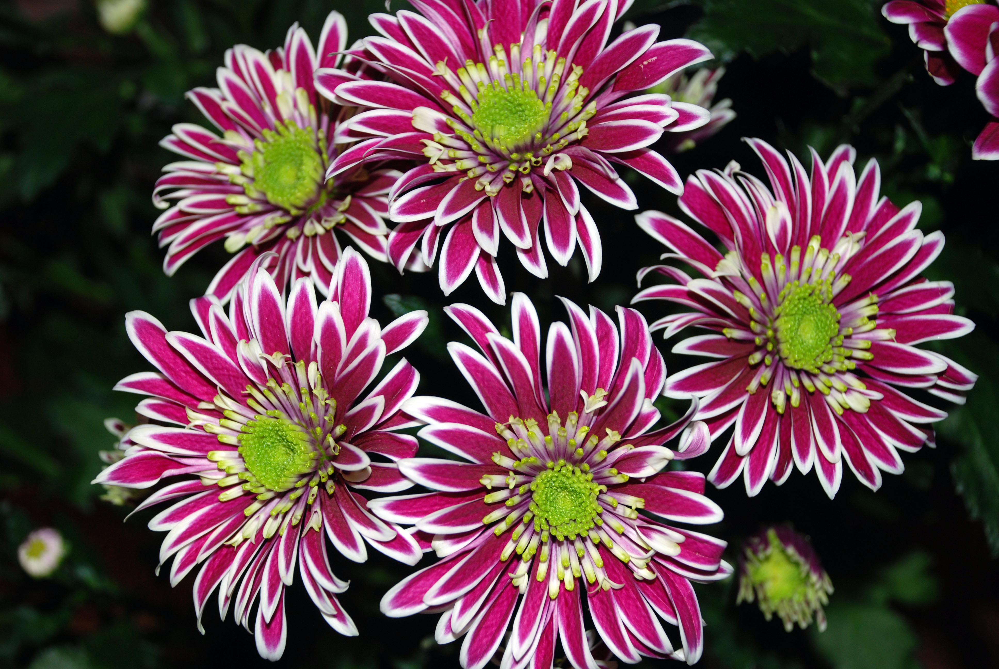

In [76]:
flower = Image.open('12.jpg')
flower

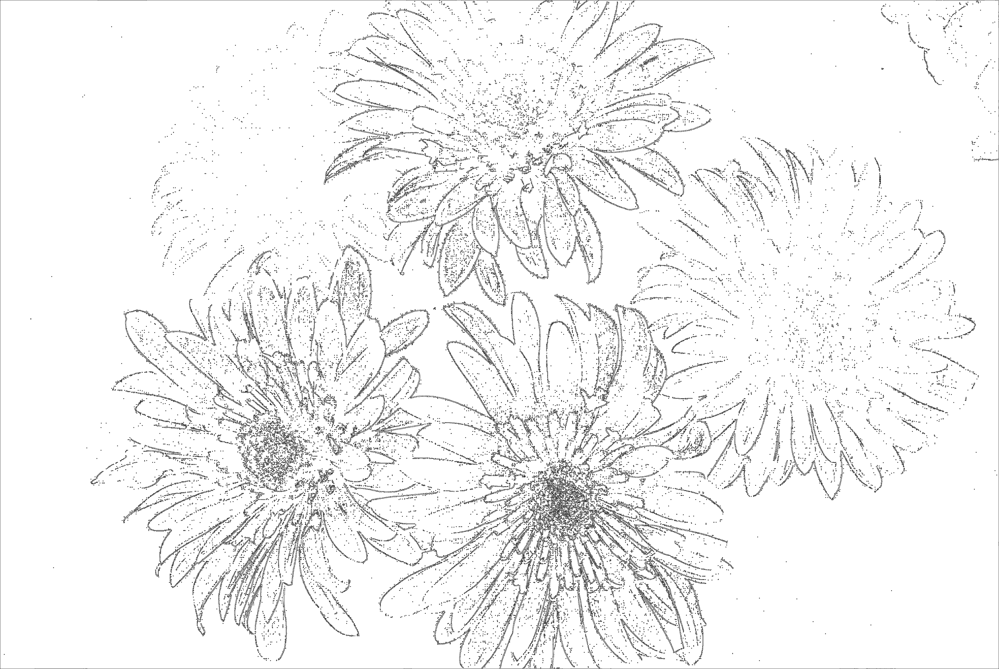

In [77]:
result_flower = flower.convert('L')
threshold = 50
result_flower = result_flower.filter(ImageFilter.FIND_EDGES)
result_flower = result_flower.point(lambda x: 255 if x > threshold else 0)
result_flower = result_flower.filter(ImageFilter.CONTOUR)
result_flower

# Task 2
Create a poster in the style of Andy Warhol’s  " Shot Marilyns ” 
Requirements: 
- convert the input image to an image with dimensions 500 500; 
- split and "shuffle" channels by adding an "empty" channel; 
- channels may repeat; 
- the order of the channels is generated randomly (for example, using random.sample() ); 
- there should be 9 images on the original poster; 
- each image must have captions indicating the channels (use ImageDraw.Draw.rectangle() and ImageDraw.Draw.text() ); 
- create 3-4 different posters. 

#### 1- opening the image

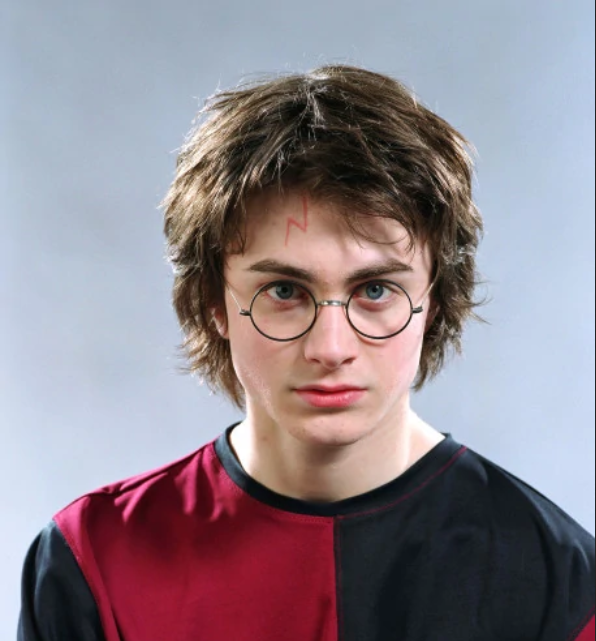

In [78]:
harry = Image.open('Garry.png')
harry

#### 2- checking the size of the image

In [79]:
harry.size

(596, 641)

#### 3 - resizing the image and then check it

In [80]:
resized_harry = harry.resize((500, 500))
resized_harry.size

(500, 500)

#### 5- getting the image channels

In [81]:
a, b, c, d = resized_harry.split()

#### 6- creating a list of dictionaries that have the bands and its representaion in a string form

In [82]:
a, b, c, d = resized_harry.split()
zero_band = a.point(lambda x: 0)

bands = [
 {'value': Image.merge('RGB',(a, c, b)), 'print': 'a + c + b'},
 {'value': Image.merge('RGB',(b, a, c)), 'print': 'b + a + c'},
 {'value': Image.merge('RGB',(b, c, a)), 'print': 'b + c + a'},
 {'value': Image.merge('RGB',(c, a, b)), 'print': 'c + a + b'},
 {'value': Image.merge('RGB',(c, b, a)), 'print': 'c + b + a'},
 {'value': Image.merge('RGB',(a, zero_band, zero_band)), 'print': 'a + zero_band + zero_band'},
 {'value': Image.merge('RGB',(a, b, zero_band)), 'print': 'a + b + zero_band'},
 {'value': Image.merge('RGB',(a, zero_band, c)), 'print': 'a + zero_band + c'},
 {'value': Image.merge('RGB',(zero_band, b, zero_band)), 'print': 'zero_band + b + zero_band'},
 {'value': Image.merge('RGB',(zero_band, b, c)), 'print': 'zero_band + b + c'},
 {'value': Image.merge('RGB',(zero_band, b, a)), 'print': 'zero_band + b + a'},
 {'value': Image.merge('RGB',(zero_band, c, a)), 'print': 'zero_band + c + a'},
 {'value': Image.merge('RGB',(zero_band, zero_band, a)), 'print': 'zero_band + zero_band + a'},
 {'value': Image.merge('RGB',(zero_band, zero_band, b)), 'print': 'zero_band + zero_band + b'},
 {'value': Image.merge('RGB',(zero_band, zero_band, c)), 'print': 'zero_band + zero_band + c'}
]

#### 7-creating a function for creating a poster that have random modes of an image

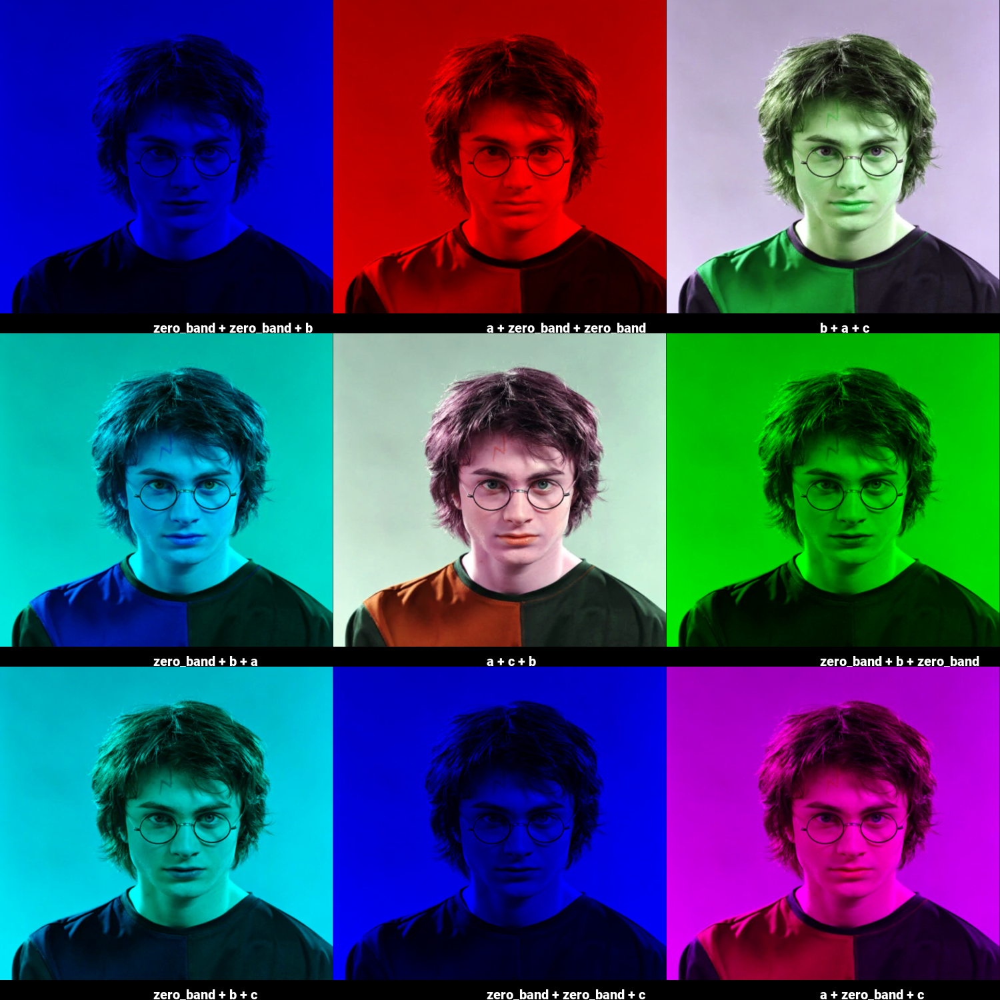

In [83]:
def create_poster(arr: list):          
    sample = random.sample(arr, 9)

    first_image = sample[0]['value']

    poster = Image.new(first_image.mode, (first_image.width*3, 
                                          first_image.height*3))

    x = 0
    y = 0

    for img in sample:
        shape = [(0, 470), (500, 500)] 
        p = ImageDraw.Draw(img['value'])
        p.rectangle(shape, outline='black', fill='black')
        font = ImageFont.truetype(font='Roboto-Black.ttf',size=20)
        p.text((230, 480), f"{img['print']}", font=font , align='left')
        poster.paste(img['value'], (x, y))
        if x + first_image.width == poster.width:
            x = 0
            y = y + first_image.height
        else:
            x = x + first_image.width
    return poster    

create_poster(bands)

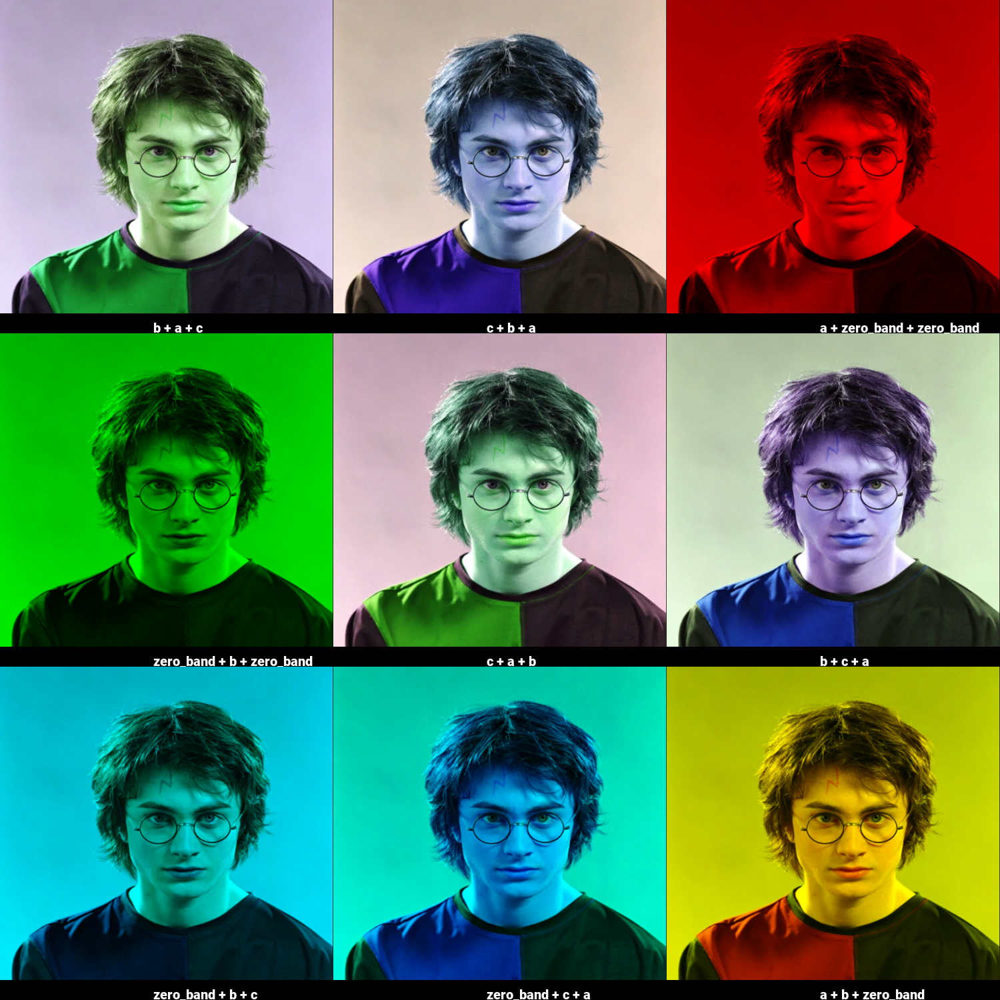

In [84]:
create_poster(bands)

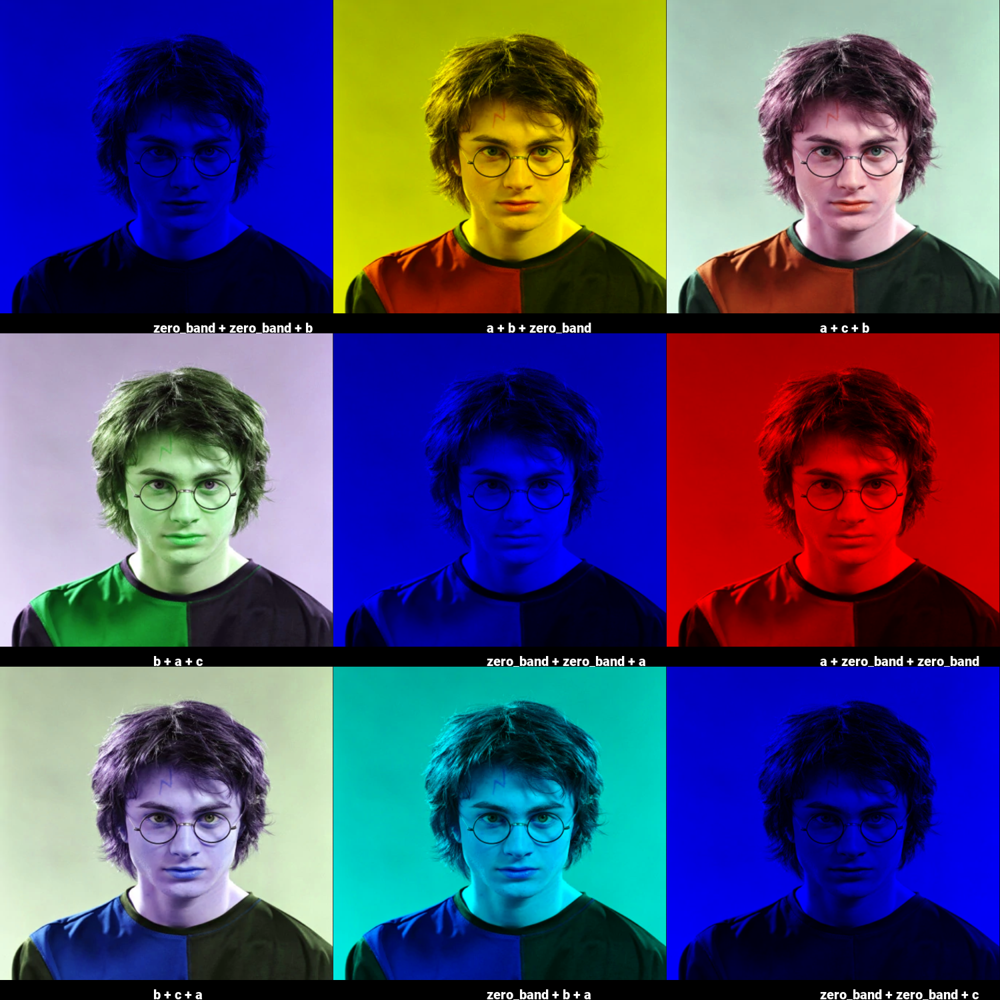

In [85]:
create_poster(bands)

#### 7- another example

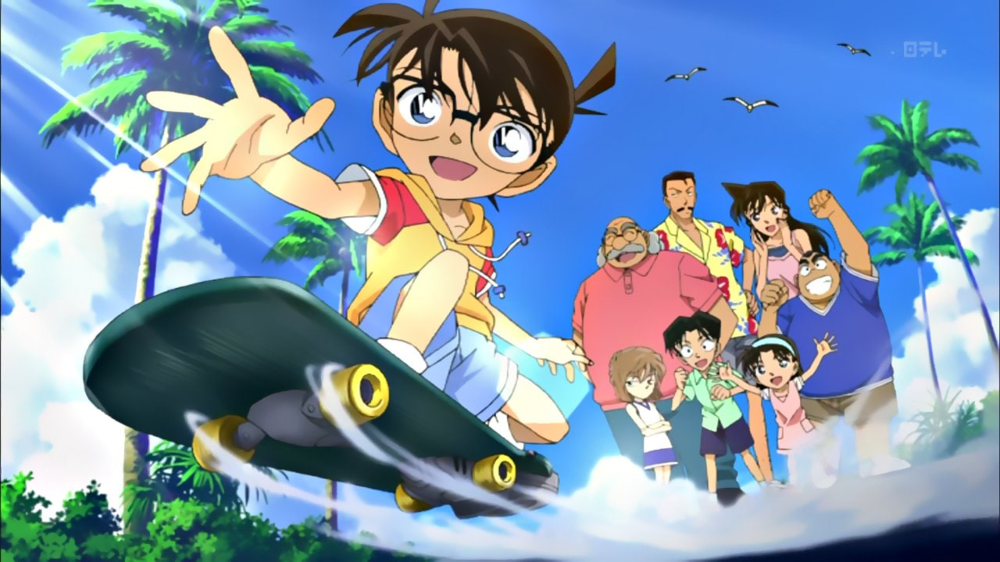

In [86]:
img2 = Image.open('wallpaperflare.com_wallpaper.jpg')
img2

In [87]:
conan = img2.resize((500, 500))
conan.size

(500, 500)

In [88]:
e,f,g = conan.split()
zero_band2 = e.point(lambda x: 0)

In [89]:
conan2 = [
 {'value': Image.merge('RGB',(e, g, f)), 'print': 'e + g + f'},
 {'value': Image.merge('RGB',(f, e, g)), 'print': 'f + e + g'},
 {'value': Image.merge('RGB',(f, g, e)), 'print': 'f + g + e'},
 {'value': Image.merge('RGB',(g, f, e)), 'print': 'g + f + e'},
 {'value': Image.merge('RGB',(g, e, f)), 'print': 'g + e + f'},
 {'value': Image.merge('RGB',(e, zero_band2, zero_band2)), 'print': 'e + zero_band + zero_band'},
 {'value': Image.merge('RGB',(e, f, zero_band2)), 'print': 'e + f + zero_band'},
 {'value': Image.merge('RGB',(e, zero_band2, g)), 'print': 'e + zero_band + g'},
 {'value': Image.merge('RGB',(zero_band2, f, zero_band2)), 'print': 'zero_band + f + zero_band'},
 {'value': Image.merge('RGB',(zero_band2, f, g)), 'print': 'zero_band + f + g'},
 {'value': Image.merge('RGB',(zero_band2, f, e)), 'print': 'zero_band + f + e'},
 {'value': Image.merge('RGB',(zero_band2, g, e)), 'print': 'zero_band + g + e'},
 {'value': Image.merge('RGB',(zero_band2, zero_band2, e)), 'print': 'zero_band + zero_band + e'},
 {'value': Image.merge('RGB',(zero_band2, zero_band2, f)), 'print': 'zero_band + zero_band + f'},
 {'value': Image.merge('RGB',(zero_band2, zero_band2, g)), 'print': 'zero_band + zero_band + g'}
]

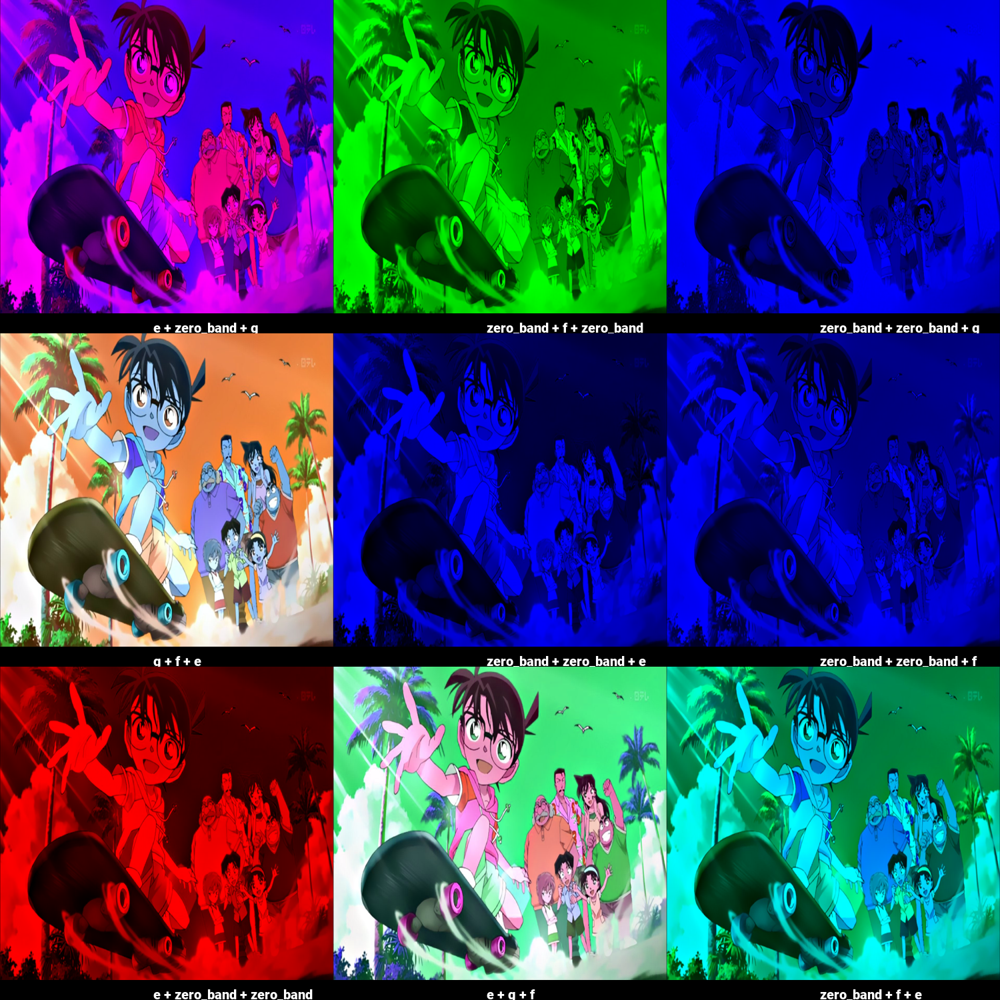

In [90]:
create_poster(conan2)

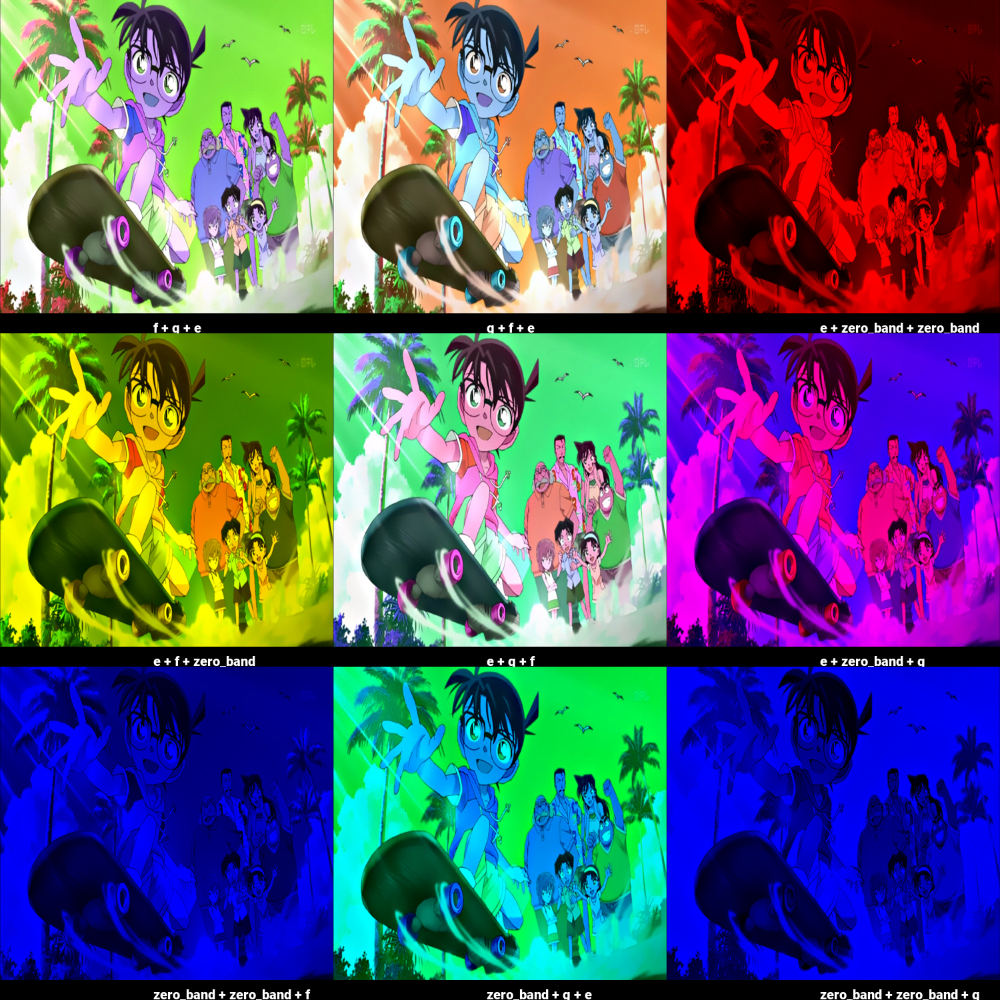

In [91]:
create_poster(conan2)